## Research Question

Determine the total number of bluecars taken from stations in Paris between Monday-Friday

## Hypothesis

### Claim Test

The same total number of bluecars are taken from stations in Paris between Monday and Friday

#### Null Hypothesis

There is no difference in the total number of bluecars taken from stations between Monday and Friday.



#### Alternative Hypothesis

There is a difference in the total number of bluecars taken from stations between Monday and Friday.

## Metrics of Success

1. Find and deal with outliers, anomalies, and missing data within the dataset.
2. Get a sample(s) of the data
3. Determine the p-value
4. Reject or accept/fail to reject the null hypothesis
5.  Plot univariate and bivariate summaries recording our observations.




## Experimental Design

I will use the CRISP_DM methodology experimental methodology to conduct this project and it ncludes the following phases:
    1. Business Understanding
    2. Data Understanding
    3. Data Preparation
    4. Modelling
    5. Evaluation

#### Importing Relevant Libraries

In [8]:
import pandas as pd
import numpy as np
# pandas profiling provides a summary report, including descriptive statistics of the dataset 
import pandas_profiling as pp
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from scipy import stats
from scipy.stats import norm
from scipy.stats import ttest_1samp
from scipy.stats import ttest_ind


### Loading Datasets

In [3]:
df=pd.read_csv("autolib_daily_events_postal_code.csv")
dictionary=pd.read_excel("columns_explanation.xlsx")

### Data Exploration

In [12]:
dictionary

,Column name,explanation
0,Postal code,postal code of the area (in Paris)
1,date,date of the row aggregation
2,n_daily_data_points,number of daily data poinst that were availabl...
3,dayOfWeek,identifier of weekday (0: Monday -> 6: Sunday)
4,day_type,weekday or weekend
5,BlueCars_taken_sum,Number of bluecars taken that date in that area
6,BlueCars_returned_sum,Number of bluecars returned that date in that ...
7,Utilib_taken_sum,Number of Utilib taken that date in that area
8,Utilib_returned_sum,Number of Utilib returned that date in that area
9,Utilib_14_taken_sum,Number of Utilib 1.4 taken that date in that area


In [4]:
df.head()

,Postal code,date,n_daily_data_points,dayOfWeek,day_type,BlueCars_taken_sum,BlueCars_returned_sum,Utilib_taken_sum,Utilib_returned_sum,Utilib_14_taken_sum,Utilib_14_returned_sum,Slots_freed_sum,Slots_taken_sum
0,75001,1/1/2018,1440,0,weekday,110,103,3,2,10,9,22,20
1,75001,1/2/2018,1438,1,weekday,98,94,1,1,8,8,23,22
2,75001,1/3/2018,1439,2,weekday,138,139,0,0,2,2,27,27
3,75001,1/4/2018,1320,3,weekday,104,104,2,2,9,8,25,21
4,75001,1/5/2018,1440,4,weekday,114,117,3,3,6,6,18,20


In [9]:
df.tail()

,Postal code,date,n_daily_data_points,dayOfWeek,day_type,BlueCars_taken_sum,BlueCars_returned_sum,Utilib_taken_sum,Utilib_returned_sum,Utilib_14_taken_sum,Utilib_14_returned_sum,Slots_freed_sum,Slots_taken_sum
16080,95880,6/15/2018,1440,4,weekday,15,10,0,0,2,3,0,0
16081,95880,6/16/2018,1440,5,weekend,19,19,0,0,2,1,0,0
16082,95880,6/17/2018,1440,6,weekend,33,35,1,1,0,0,0,0
16083,95880,6/18/2018,1440,0,weekday,11,14,3,5,2,2,0,0
16084,95880,6/19/2018,1370,1,weekday,2,2,2,1,0,0,0,0


In [14]:
df.sample(50)

,Postal code,date,n_daily_data_points,dayOfWeek,day_type,BlueCars_taken_sum,BlueCars_returned_sum,Utilib_taken_sum,Utilib_returned_sum,Utilib_14_taken_sum,Utilib_14_returned_sum,Slots_freed_sum,Slots_taken_sum
797,75006,1/18/2018,1439,3,weekday,256,250,11,10,18,16,57,54
8186,92350,3/31/2018,1440,5,weekend,29,30,1,1,4,3,0,0
6344,92220,4/21/2018,1440,5,weekend,64,57,1,0,3,4,0,0
1033,75007,4/11/2018,1439,2,weekday,301,312,5,5,21,21,93,95
11855,93370,2/23/2018,1440,4,weekday,4,2,0,0,0,0,0,0
222,75002,3/11/2018,1440,6,weekend,167,171,9,9,14,14,46,42
8453,92370,2/14/2018,1440,2,weekday,23,22,0,1,5,4,0,0
2155,75014,5/22/2018,1438,1,weekday,480,504,27,28,31,29,154,165
6955,92260,4/8/2018,1440,6,weekend,35,42,1,0,6,7,0,0
3619,78140,2/2/2018,1440,4,weekday,39,37,3,2,2,2,0,0


In [10]:
df.shape

(16085, 13)

In [11]:
len(df)

16085

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16085 entries, 0 to 16084
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Postal code             16085 non-null  int64 
 1   date                    16085 non-null  object
 2   n_daily_data_points     16085 non-null  int64 
 3   dayOfWeek               16085 non-null  int64 
 4   day_type                16085 non-null  object
 5   BlueCars_taken_sum      16085 non-null  int64 
 6   BlueCars_returned_sum   16085 non-null  int64 
 7   Utilib_taken_sum        16085 non-null  int64 
 8   Utilib_returned_sum     16085 non-null  int64 
 9   Utilib_14_taken_sum     16085 non-null  int64 
 10  Utilib_14_returned_sum  16085 non-null  int64 
 11  Slots_freed_sum         16085 non-null  int64 
 12  Slots_taken_sum         16085 non-null  int64 
dtypes: int64(11), object(2)
memory usage: 1.6+ MB


In [16]:
df.dtypes

Postal code                int64
date                      object
n_daily_data_points        int64
dayOfWeek                  int64
day_type                  object
BlueCars_taken_sum         int64
BlueCars_returned_sum      int64
Utilib_taken_sum           int64
Utilib_returned_sum        int64
Utilib_14_taken_sum        int64
Utilib_14_returned_sum     int64
Slots_freed_sum            int64
Slots_taken_sum            int64
dtype: object

In [17]:
df.columns

Index(['Postal code', 'date', 'n_daily_data_points', 'dayOfWeek', 'day_type',
       'BlueCars_taken_sum', 'BlueCars_returned_sum', 'Utilib_taken_sum',
       'Utilib_returned_sum', 'Utilib_14_taken_sum', 'Utilib_14_returned_sum',
       'Slots_freed_sum', 'Slots_taken_sum'],
      dtype='object')

In [18]:
df.describe()

,Postal code,n_daily_data_points,dayOfWeek,BlueCars_taken_sum,BlueCars_returned_sum,Utilib_taken_sum,Utilib_returned_sum,Utilib_14_taken_sum,Utilib_14_returned_sum,Slots_freed_sum,Slots_taken_sum
count,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000,16085.000000
mean,88791.293876,1431.330619,2.969599,125.926951,125.912714,3.698290,3.699099,8.600560,8.599192,22.629033,22.629282
std,7647.342000,33.212050,2.008378,185.426579,185.501535,5.815058,5.824634,12.870098,12.868993,52.120263,52.146030
min,75001.000000,1174.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,91330.000000,1439.000000,1.000000,20.000000,20.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000
50%,92340.000000,1440.000000,3.000000,46.000000,46.000000,1.000000,1.000000,3.000000,3.000000,0.000000,0.000000
75%,93400.000000,1440.000000,5.000000,135.000000,135.000000,4.000000,4.000000,10.000000,10.000000,5.000000,5.000000
max,95880.000000,1440.000000,6.000000,1352.000000,1332.000000,54.000000,58.000000,100.000000,101.000000,360.000000,359.000000


In [19]:
pp.ProfileReport(df)

## Data Cleaning

In [20]:
###making a copy of our dataset so that we dont tamper with our original dataset
autolib_df= df.copy()


In [28]:
## Removing white spaces and lowercasing the columns
autolib_df.columns = autolib_df.columns.str.replace(' ', '_').str.lower()
autolib_df


,postal_code,date,n_daily_data_points,dayofweek,day_type,bluecars_taken_sum,bluecars_returned_sum,utilib_taken_sum,utilib_returned_sum,utilib_14_taken_sum,utilib_14_returned_sum,slots_freed_sum,slots_taken_sum
0,75001,1/1/2018,1440,0,weekday,110,103,3,2,10,9,22,20
1,75001,1/2/2018,1438,1,weekday,98,94,1,1,8,8,23,22
2,75001,1/3/2018,1439,2,weekday,138,139,0,0,2,2,27,27
3,75001,1/4/2018,1320,3,weekday,104,104,2,2,9,8,25,21
4,75001,1/5/2018,1440,4,weekday,114,117,3,3,6,6,18,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...
16080,95880,6/15/2018,1440,4,weekday,15,10,0,0,2,3,0,0
16081,95880,6/16/2018,1440,5,weekend,19,19,0,0,2,1,0,0
16082,95880,6/17/2018,1440,6,weekend,33,35,1,1,0,0,0,0
16083,95880,6/18/2018,1440,0,weekday,11,14,3,5,2,2,0,0


In [23]:
## Checking for null values
autolib_df.isnull().sum()
##No null values in dataset

Postal code               0
date                      0
n_daily_data_points       0
dayOfWeek                 0
day_type                  0
BlueCars_taken_sum        0
BlueCars_returned_sum     0
Utilib_taken_sum          0
Utilib_returned_sum       0
Utilib_14_taken_sum       0
Utilib_14_returned_sum    0
Slots_freed_sum           0
Slots_taken_sum           0
dtype: int64

In [26]:
## checking for duplicates
autolib_df.duplicated().sum()
## No duplicates in our dataset

0

In [30]:
## # converting date column to datetime
autolib_df.date = pd.to_datetime(autolib_df.date)
autolib_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16085 entries, 0 to 16084
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   postal_code             16085 non-null  int64         
 1   date                    16085 non-null  datetime64[ns]
 2   n_daily_data_points     16085 non-null  int64         
 3   dayofweek               16085 non-null  int64         
 4   day_type                16085 non-null  object        
 5   bluecars_taken_sum      16085 non-null  int64         
 6   bluecars_returned_sum   16085 non-null  int64         
 7   utilib_taken_sum        16085 non-null  int64         
 8   utilib_returned_sum     16085 non-null  int64         
 9   utilib_14_taken_sum     16085 non-null  int64         
 10  utilib_14_returned_sum  16085 non-null  int64         
 11  slots_freed_sum         16085 non-null  int64         
 12  slots_taken_sum         16085 non-null  int64 

In [35]:
# # selecting columns where day_type = weekday because I will be working with weekdays only
new_autolib= autolib_df[autolib_df['day_type'] == 'weekday']
new_autolib.sample(5)


,postal_code,date,n_daily_data_points,dayofweek,day_type,bluecars_taken_sum,bluecars_returned_sum,utilib_taken_sum,utilib_returned_sum,utilib_14_taken_sum,utilib_14_returned_sum,slots_freed_sum,slots_taken_sum
4884,92120,2018-02-21,1440,2,weekday,72,75,3,3,13,14,0,0
15349,94700,2018-02-14,1440,2,weekday,30,22,1,2,3,2,0,0
9380,92500,2018-02-07,1439,2,weekday,90,89,3,4,4,6,0,0
14413,94230,2018-02-13,1440,1,weekday,45,46,0,0,4,3,0,0
11715,93360,2018-03-13,1440,1,weekday,20,19,1,0,0,0,0,0


In [ ]:
## Dropping unnecessary columns that will not be valid to our analysis
## day_type, n_daily_data_points
new_autolib = new_autolib.drop(['day_type', 'n_daily_data_points'], 1)


In [38]:
new_autolib.columns

Index(['postal_code', 'date', 'dayofweek', 'bluecars_taken_sum',
       'bluecars_returned_sum', 'utilib_taken_sum', 'utilib_returned_sum',
       'utilib_14_taken_sum', 'utilib_14_returned_sum', 'slots_freed_sum',
       'slots_taken_sum'],
      dtype='object')

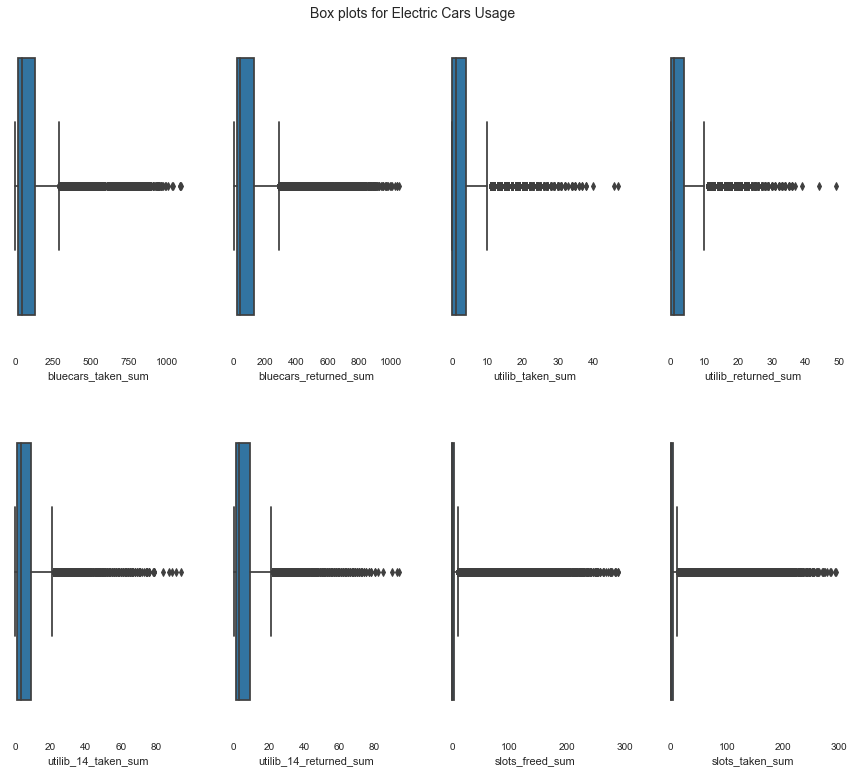

In [40]:
## # checking for outliers in columns[3:]
box, axx = plt.subplots(2,4, figsize=(15,13))
box.suptitle('Box plots for Electric Cars Usage', fontsize=14, y=0.9)
for ax, column in zip(axx.flatten(), new_autolib.columns[3:]):
      sns.boxplot(new_autolib[column], ax=ax)


## There are presence of outliers in the plotted columns but I wont drop them since there are reasonable

In [43]:
##   using pandas profiling to get a summarized report of the dataset
pp.ProfileReport(new_autolib)




## Data Analysis

In [47]:
# checking for unique values in the postal_code column
print(new_autolib.postal_code.unique())
print('\nNumber of unique values in postal_code column: %d' % len(new_autolib.postal_code.unique()))


[75001 75002 75003 75004 75005 75006 75007 75008 75009 75010 75011 75012
 75013 75014 75015 75016 75017 75018 75019 75020 75112 75116 78000 78140
 78150 91330 91370 91400 92000 92100 92110 92120 92130 92140 92150 92160
 92170 92190 92200 92210 92220 92230 92240 92250 92260 92270 92290 92300
 92310 92320 92330 92340 92350 92360 92370 92380 92390 92400 92410 92420
 92500 92600 92700 92800 93100 93110 93130 93150 93170 93200 93230 93260
 93300 93310 93350 93360 93370 93390 93400 93440 93500 93600 93700 93800
 94000 94100 94110 94120 94130 94140 94150 94160 94220 94230 94300 94340
 94410 94450 94500 94700 94800 95100 95870 95880]

Number of unique values in postal_code column: 104


In [48]:

# checking for unique values in the dayofweek column
new_autolib.dayofweek.unique()

array([0, 1, 2, 3, 4])

In [49]:
## Sum of Blue cars in a week taken
new_autolib.groupby('dayofweek')[['bluecars_taken_sum']].sum().sort_values('bluecars_taken_sum', ascending=False)


,bluecars_taken_sum
dayofweek,
4,288546
0,263893
3,263207
1,261940
2,261849


In [50]:
## Sum of Blue cars in a week returned
new_autolib.groupby('dayofweek')[['bluecars_returned_sum']].sum().sort_values('bluecars_returned_sum', ascending=False)


,bluecars_returned_sum
dayofweek,
4,286029
0,264808
3,262961
2,260673
1,260470


## Univariate Analysis

In [51]:
## Measures of central tendency
new_autolib.describe()

,postal_code,dayofweek,bluecars_taken_sum,bluecars_returned_sum,utilib_taken_sum,utilib_returned_sum,utilib_14_taken_sum,utilib_14_returned_sum,slots_freed_sum,slots_taken_sum
count,11544.000000,11544.000000,11544.000000,11544.000000,11544.000000,11544.000000,11544.000000,11544.000000,11544.000000,11544.000000
mean,88789.959286,1.973926,116.028673,115.639380,3.424983,3.417620,7.999047,7.975485,20.945166,20.921431
std,7647.995374,1.417797,169.626905,168.344751,5.379950,5.349742,11.963164,11.882660,47.900208,47.848580
min,75001.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,91330.000000,1.000000,18.000000,19.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000
50%,92340.000000,2.000000,42.000000,42.000000,1.000000,1.000000,3.000000,3.000000,0.000000,0.000000
75%,93400.000000,3.000000,126.000000,126.000000,4.000000,4.000000,9.000000,9.000000,4.000000,5.000000
max,95880.000000,4.000000,1093.000000,1056.000000,47.000000,49.000000,94.000000,94.000000,288.000000,294.000000


In [54]:
##mean
# mean of bluecars_returned_sum, bluecars_taken_sum, slots_freed_sum & slots_taken_sum 
num_col = ['bluecars_returned_sum', 'bluecars_taken_sum', 'slots_freed_sum', 'slots_taken_sum']
for column in num_col:
      print('mean of {}: {:.2f}' .format(column, new_autolib[column].mean()))



mean of bluecars_returned_sum: 115.64
mean of bluecars_taken_sum: 116.03
mean of slots_freed_sum: 20.95
mean of slots_taken_sum: 20.92


In [55]:
# median of bluecars_returned_sum, bluecars_taken_sum, slots_freed_sum, slots_taken_sum 

num_col = ['bluecars_returned_sum', 'bluecars_taken_sum', 'slots_freed_sum', 'slots_taken_sum']

for column in num_col:
  print('median of %s: %d' % (column, new_autolib[column].median()))

median of bluecars_returned_sum: 42
median of bluecars_taken_sum: 42
median of slots_freed_sum: 0
median of slots_taken_sum: 0


In [56]:
# mode of bluecars_returned_sum, bluecars_taken_sum, slots_freed_sum, slots_taken_sum & of dayofweek

num_co = ['bluecars_returned_sum', 'bluecars_taken_sum', 'slots_freed_sum', 'slots_taken_sum', 'dayofweek']

for column in num_co:
  print('mode of %s: %d' % (column, new_autolib[column].mode()))
  
# day 0/Monday features the most in the dataset
# in most cases, the sum of either returned bluecars or taken bluecars was 12

mode of bluecars_returned_sum: 12
mode of bluecars_taken_sum: 12
mode of slots_freed_sum: 0
mode of slots_taken_sum: 0
mode of dayofweek: 0


In [57]:
## Measures of dispersion
# variance of bluecars_returned_sum, bluecars_taken_sum, 
# slots_freed_sum & slots_taken_sum columns

num_col = ['bluecars_returned_sum', 'bluecars_taken_sum', 'slots_freed_sum', 'slots_taken_sum']

for column in num_col:
  print('Variance of {}: {:.2f}' .format(column, new_autolib[column].var()))

# there is a significantly high variance in the distribution of bluecars taken

Variance of bluecars_returned_sum: 28339.96
Variance of bluecars_taken_sum: 28773.29
Variance of slots_freed_sum: 2294.43
Variance of slots_taken_sum: 2289.49


In [58]:
# standard deviation of bluecars_returned_sum, bluecars_taken_sum, 
# slots_freed_sum & slots_taken_sum columns

num_col = ['bluecars_returned_sum', 'bluecars_taken_sum', 'slots_freed_sum', 'slots_taken_sum']

for column in num_col:
  print('Standard deviation of {}: {:.2f}' .format(column, new_autolib[column].std()))
  
# there is great standard deviation in the distribution of the sum of bluecars taken

Standard deviation of bluecars_returned_sum: 168.34
Standard deviation of bluecars_taken_sum: 169.63
Standard deviation of slots_freed_sum: 47.90
Standard deviation of slots_taken_sum: 47.85


In [60]:
# skewness of bluecars_returned_sum, bluecars_taken_sum, 
# slots_freed_sum & slots_taken_sum columns

num_col = ['bluecars_returned_sum', 'bluecars_taken_sum', 'slots_freed_sum', 'slots_taken_sum']

for column in num_col:
  print('Skewness of {}: {:.2f}' .format(column, new_autolib[column].skew()))
# the distribution of bluecars taken and slots taken exhibit positive skewness (i.e., are skewed to the right)
# the modes of bluecars taken & slotes taken are less than the mean of bluecars taken and slots taken respectively.

Skewness of bluecars_returned_sum: 2.33
Skewness of bluecars_taken_sum: 2.33
Skewness of slots_freed_sum: 2.54
Skewness of slots_taken_sum: 2.54


In [61]:
# kurtosis of bluecars_returned_sum, bluecars_taken_sum, 
# slots_freed_sum & slots_taken_sum columns

for column in num_col:
  print('Kurtosis of {}: {:.2f}' .format(column, new_autolib[column].kurt()))
  
# distribution of the sum of bluecars taken and sum of slots taken 
# has positive kurtosis indicating the presence/profusion of outliers
# distribution can be described as heavy-tailed/leptokurtic

Kurtosis of bluecars_returned_sum: 5.54
Kurtosis of bluecars_taken_sum: 5.55
Kurtosis of slots_freed_sum: 6.01
Kurtosis of slots_taken_sum: 6.00


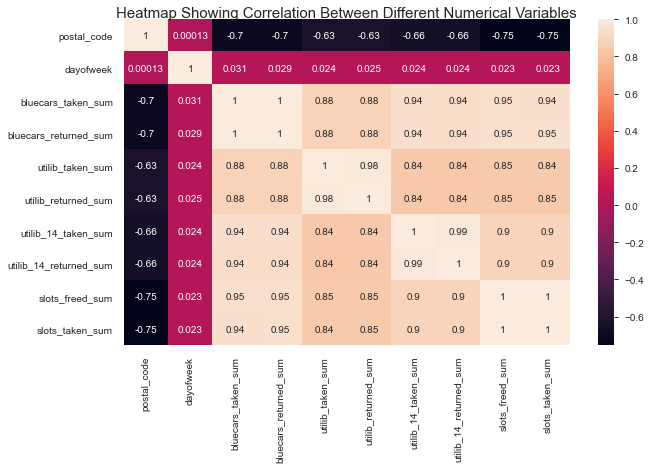

In [63]:
## Heatmap
heatmap = new_autolib.corr()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap, xticklabels=heatmap.columns, yticklabels=heatmap.columns, annot=True)
plt.title('Heatmap Showing Correlation Between Different Numerical Variables', fontsize=15, pad=2)
plt.show()

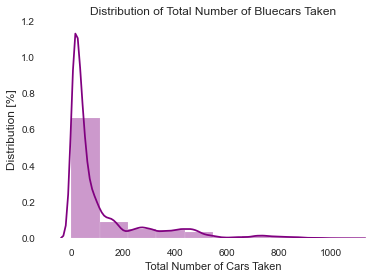

In [65]:
# histogram showing the distribution of total number of cars taken

plt.figure(figsize=(6,4))
dis = sns.distplot(new_autolib.bluecars_taken_sum, bins=10, color='purple')
plt.xlabel('Total Number of Cars Taken')
plt.yticks(dis.get_yticks(), dis.get_yticks() * 100)
plt.ylabel('Distribution [%]', fontsize=12)
plt.title('Distribution of Total Number of Bluecars Taken')
plt.show()

# most common total number of bluecars taken was between 0-100

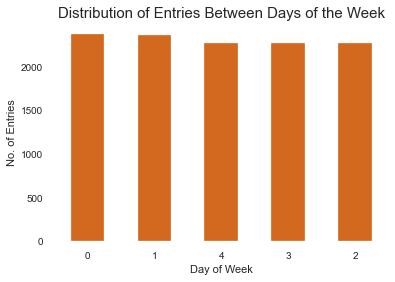

In [98]:
# barplot showing the distribution of entries/observations between mon-fri


new_autolib.dayofweek.value_counts().plot(kind='bar', figsize=(6,4), color='chocolate')
plt.xticks(rotation=360)
plt.xlabel('Day of Week')
plt.ylabel('No. of Entries')
plt.title('Distribution of Entries Between Days of the Week', fontsize=15)
plt.show()

# no. of entries for each day of week are somewhat evenly distributed ranging between 2200-2400
# monday(0) and tuesday(1) had slightly more entries

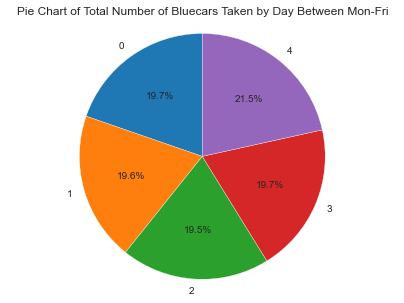

In [99]:
# days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']

au = new_autolib.groupby('dayofweek')[['bluecars_taken_sum']].sum().reset_index()
au

plt.figure(figsize=(7,5))
plt.pie(au.bluecars_taken_sum, labels=au.dayofweek, autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.title('Pie Chart of Total Number of Bluecars Taken by Day Between Mon-Fri')
plt.show()

# according to the pie chart, total number of cars was highest on Friday, contributing to 21.5%
# of the total number of bluecars taken during the weekdays

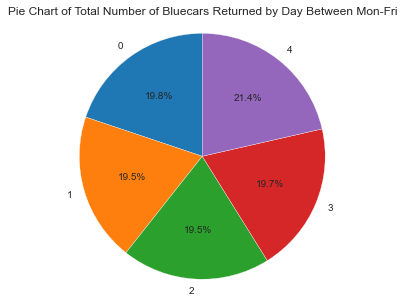

In [100]:
br = new_autolib.groupby('dayofweek')['bluecars_returned_sum'].sum().reset_index()
plt.figure(figsize=(7,5))
plt.pie(br.bluecars_returned_sum, labels=br.dayofweek, autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.title('Pie Chart of Total Number of Bluecars Returned by Day Between Mon-Fri')
plt.show()

## Bivariate Analysis


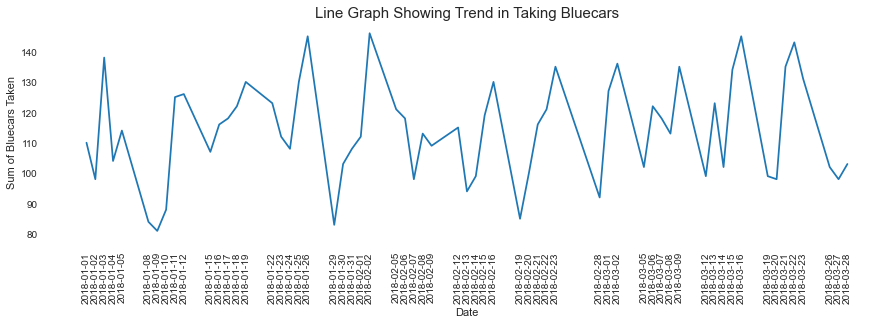

In [101]:
autm = new_autolib.iloc[:61,:]   # selecting the first 60 observations from the autob dataframe.

# plotting a line graph of sum of bluecars taken and sum of recharging slots freed
plt.figure(figsize=(15,4))
plt.plot(autm.date, autm.bluecars_taken_sum)
plt.xticks(autm.date, rotation=90)

plt.xlabel('Date')
plt.ylabel('Sum of Bluecars Taken')
plt.title('Line Graph Showing Trend in Taking Bluecars', fontsize=15)
plt.show()

# output reveals a constant fluctuation in the trend of taking bluecars
# for the three month period between 2018/01/01 - 2018/03/28
# lowest number of sum of bluecars taken was on 09/01/2018
# the other two days when the sum of bluecars taken was lowest were 29/01/2018 and 19/02/2018 (Trend in low sum of bluecars taken in afer every twenty days)

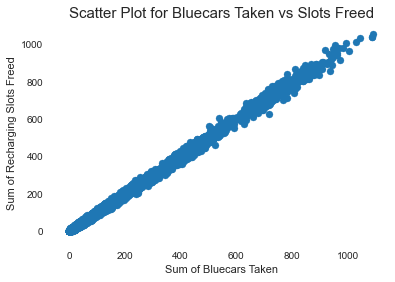

In [103]:
plt.figure(figsize=(6,4))
plt.scatter(new_autolib.bluecars_taken_sum, new_autolib.bluecars_returned_sum)
plt.xlabel('Sum of Bluecars Taken')
plt.ylabel('Sum of Recharging Slots Freed')
plt.title('Scatter Plot for Bluecars Taken vs Slots Freed', fontsize=15)
plt.show()

# scatter plot reveals a perfect linear relationship (i.e positive correlation) between the sum of bluecars taken and sum of bluecars returned.
# the two columns can be considered to provide the same information

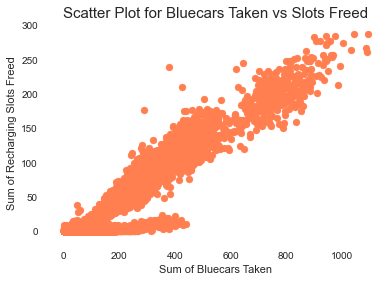

In [104]:
plt.figure(figsize=(6,4))
plt.scatter(new_autolib.bluecars_taken_sum, new_autolib.slots_freed_sum, color='coral')
plt.xlabel('Sum of Bluecars Taken')
plt.ylabel('Sum of Recharging Slots Freed')
plt.title('Scatter Plot for Bluecars Taken vs Slots Freed', fontsize=15)
plt.show()

# scatter plot reveals sum of bluecars taken and sum of slots freed are highly correlated (i.e positive correlation)

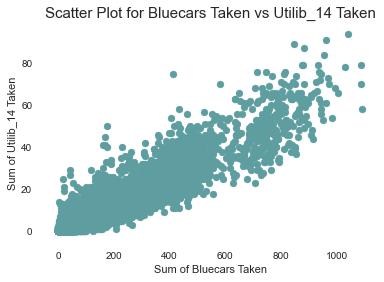

In [105]:
plt.figure(figsize=(6,4))
plt.scatter(new_autolib.bluecars_taken_sum, new_autolib.utilib_14_taken_sum, color='cadetblue')
plt.xlabel('Sum of Bluecars Taken')
plt.ylabel('Sum of Utilib_14 Taken')
plt.title('Scatter Plot for Bluecars Taken vs Utilib_14 Taken', fontsize=15)
plt.show()

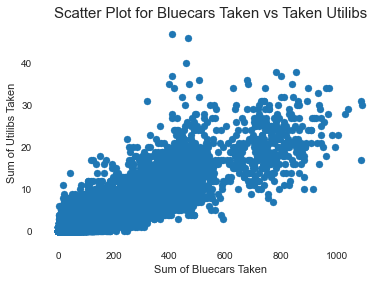

In [106]:
plt.figure(figsize=(6,4))
plt.scatter(new_autolib.bluecars_taken_sum, new_autolib.utilib_taken_sum)
plt.xlabel('Sum of Bluecars Taken')
plt.ylabel('Sum of Utilibs Taken')
plt.title('Scatter Plot for Bluecars Taken vs Taken Utilibs', fontsize=15)
plt.show()

# scatter plot shows a positive correlation between sum of returned utilibs and sum of bluecars taken

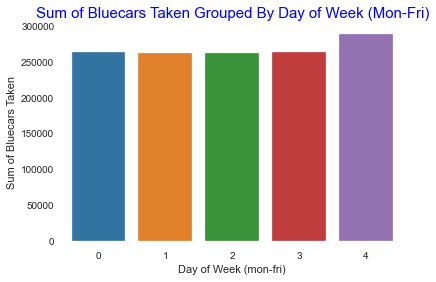

In [109]:
# plotting a bar graph of Sum of bluecars taken vs Day of Week
plt.figure(figsize=(6,4))
sns.barplot(x=au.index, y=au.bluecars_taken_sum)
plt.ylabel('Sum of Bluecars Taken')
plt.xlabel('Day of Week (mon-fri)')
plt.title('Sum of Bluecars Taken Grouped By Day of Week (Mon-Fri)', fontsize=15, color='blue')
plt.show()

# total sum of bluecars taken is relatively similar between Monday(0) and Thursday(3)
# Friday recorded the highest total number of bluecars taken

### Correlation

In [110]:
# pearson/standard correlation coefficient between sum of bluecars taken and sum of utilibs returned

pearson = new_autolib.bluecars_taken_sum.corr(new_autolib.utilib_taken_sum, method='pearson')
print('pearson correlation coefficient: %.4f' % pearson)

# output reveals a strong positive correlation between the sum of bluecars taken and the sum of utilibs taken

pearson correlation coefficient: 0.8842


In [111]:
# pearson/standard correlation coefficient between sum of bluecars taken and sum of utilibs returned

pearson = new_autolib.bluecars_taken_sum.corr(new_autolib.utilib_14_taken_sum, method='pearson')
print('pearson correlation coefficient: %.4f' % pearson)

# output reveals a strong positive correlation between the sum of bluecars taken and the sum of utilib_14 taken

pearson correlation coefficient: 0.9387


In [112]:
# pearson/standard correlation coefficient between sum of bluecars taken and sum of utilibs returned

pearson = new_autolib.bluecars_taken_sum.corr(new_autolib.slots_freed_sum, method='pearson')
print('pearson correlation coefficient: %.4f' % pearson)

# output reveals a strong positive correlation between the sum of bluecars taken and the sum of recharging slots freed

pearson correlation coefficient: 0.9457


In [113]:
# pearson/standard correlation coefficient between sum of bluecars taken and sum of utilibs returned

pearson = new_autolib.bluecars_taken_sum.corr(new_autolib.bluecars_returned_sum, method='pearson')
print('pearson correlation coefficient: %.4f' % pearson)

# output reveals a perfect linear correlation between the sum of bluecars taken and the sum of bluecars returned

pearson correlation coefficient: 0.9988


## Multivariate Analysis


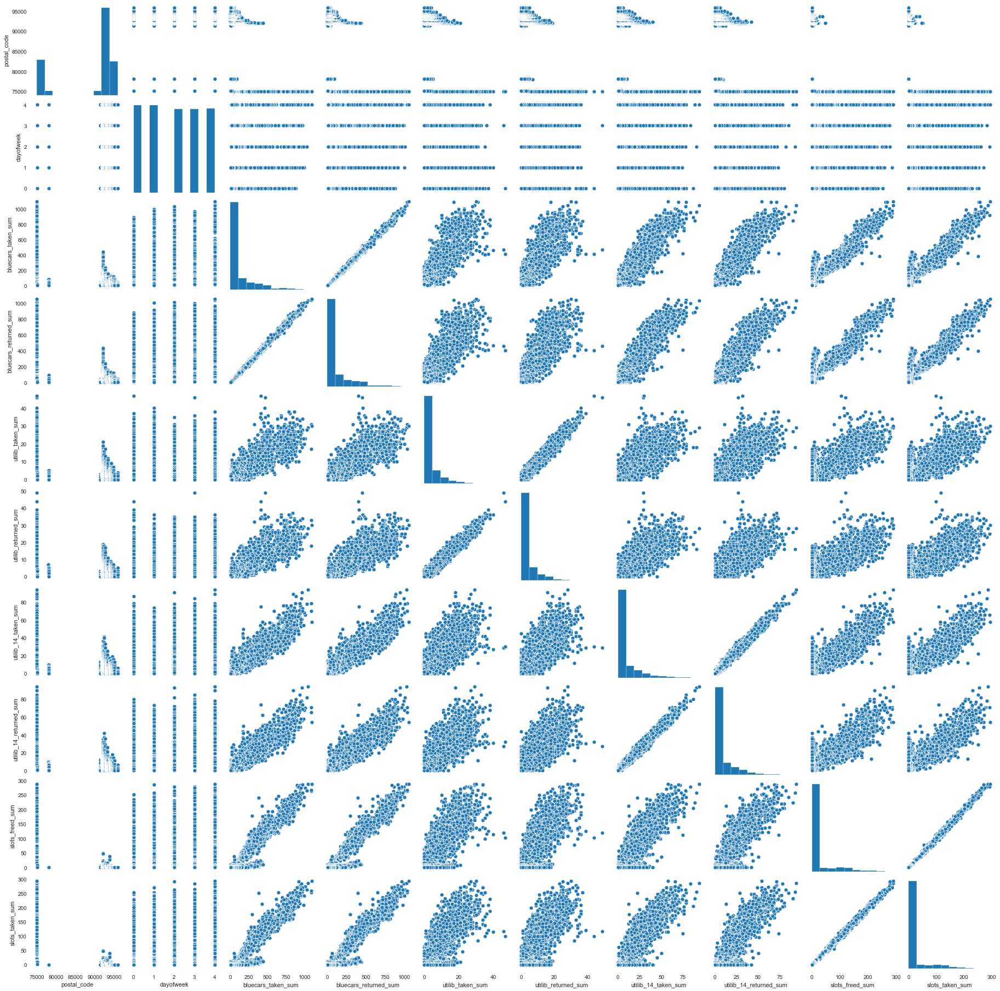

In [114]:
# pairplot of scatter plot and histogram of the columns in the dataframe

sns.pairplot(new_autolib)
plt.show()

In [115]:
# getting the correlation of numerical variables in the dataframe

new_autolib.corr()

,postal_code,dayofweek,bluecars_taken_sum,bluecars_returned_sum,utilib_taken_sum,utilib_returned_sum,utilib_14_taken_sum,utilib_14_returned_sum,slots_freed_sum,slots_taken_sum
postal_code,1.000000,0.000130,-0.701709,-0.701877,-0.629116,-0.629190,-0.661567,-0.661256,-0.754730,-0.754422
dayofweek,0.000130,1.000000,0.030798,0.028943,0.024498,0.025010,0.024469,0.024331,0.022517,0.022582
bluecars_taken_sum,-0.701709,0.030798,1.000000,0.998780,0.884239,0.883856,0.938730,0.937613,0.945700,0.944855
bluecars_returned_sum,-0.701877,0.028943,0.998780,1.000000,0.884533,0.884332,0.939084,0.938248,0.945758,0.946006
utilib_taken_sum,-0.629116,0.024498,0.884239,0.884533,1.000000,0.979469,0.836193,0.835359,0.845480,0.844701
utilib_returned_sum,-0.629190,0.025010,0.883856,0.884332,0.979469,1.000000,0.835772,0.835549,0.845527,0.845376
utilib_14_taken_sum,-0.661567,0.024469,0.938730,0.939084,0.836193,0.835772,1.000000,0.990960,0.895978,0.895574
utilib_14_returned_sum,-0.661256,0.024331,0.937613,0.938248,0.835359,0.835549,0.990960,1.000000,0.895244,0.895647
slots_freed_sum,-0.754730,0.022517,0.945700,0.945758,0.845480,0.845527,0.895978,0.895244,1.000000,0.999154
slots_taken_sum,-0.754422,0.022582,0.944855,0.946006,0.844701,0.845376,0.895574,0.895647,0.999154,1.000000


In [116]:
## Dropping columns not required for our hypothesis
autoli = new_autolib.drop(['postal_code', 'bluecars_returned_sum', 'utilib_returned_sum', 'utilib_14_returned_sum'], 1)
autoli.columns

Index(['date', 'dayofweek', 'bluecars_taken_sum', 'utilib_taken_sum',
       'utilib_14_taken_sum', 'slots_freed_sum', 'slots_taken_sum'],
      dtype='object')

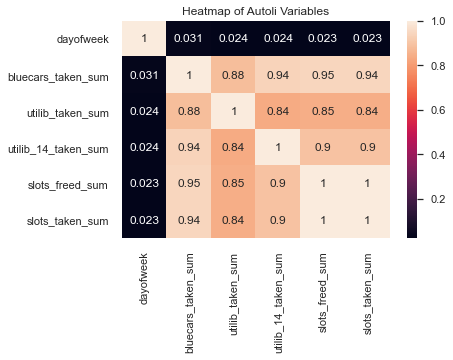

In [117]:
# heatmap showing correlation between variables in the autoli dataframe
sns.set()
sns.heatmap(autoli.corr(), annot=True)
plt.title('Heatmap of Autoli Variables')
plt.show()

## Hypothesis testing

#### I Will use a Simple Random Sample is this project

In [125]:
## Size of sample is 30% of the data
blue_car_sample = new_autolib.sample(frac=0.3, random_state=101)
blue_car_sample.head()

,postal_code,date,dayofweek,bluecars_taken_sum,bluecars_returned_sum,utilib_taken_sum,utilib_returned_sum,utilib_14_taken_sum,utilib_14_returned_sum,slots_freed_sum,slots_taken_sum
5677,92170,2018-03-09,4,83,84,0,0,5,4,0,0
3738,78140,2018-06-15,4,31,31,1,0,4,4,0,0
7153,92270,2018-05-31,3,30,24,0,0,3,5,0,0
14707,94340,2018-01-26,4,48,51,0,0,4,3,0,0
7921,92330,2018-05-08,1,44,40,1,2,5,9,4,2


In [127]:
## Shape of our sample
blue_car_sample.shape

(3463, 11)

In [130]:
# grouping sample 1 by dayofweek and displaying sum of bluecars taken
taken=blue_car_sample.groupby('dayofweek')[['bluecars_taken_sum']].sum().reset_index()
taken['dayofweek'] = taken['dayofweek'].map({0: 'Monday', 1: 'Tuesday', 2: 'Wednesday', 3: 'Thursday', 4: 'Friday'})
taken

,dayofweek,bluecars_taken_sum
0,Monday,80151
1,Tuesday,81031
2,Wednesday,79700
3,Thursday,80698
4,Friday,89593


In [136]:
# we'll be comparing numerical and categorical variables. Therfore, we will use a chi square test to test our hypothesis
# specifically, we will use  a chi square goodness of fit


observed = list(taken['bluecars_taken_sum'])
total = sum(observed)
expected = [round(total/5)]

# magnitude of repetition declaration
mag = 5

# list comprehension
expected = [item for item in expected for i in range(mag)]

In [137]:
import scipy, scipy.stats
from scipy.stats import chisquare
ob_val = scipy.array(observed)
exp_val = scipy.array(expected)

chi = chisquare(f_obs=ob_val, f_exp=exp_val)
print('Chi square test statistic: {} \np value: {}'.format(chi[0],chi[1]))
print('p value rounded off to four dp:', round(chi[1],4))

Chi square test statistic: 835.6713078372956 
p value: 1.4398750459546759e-179
p value rounded off to four dp: 0.0


/root/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: scipy.array is deprecated and will be removed in SciPy 2.0.0, use numpy.array instead
  This is separate from the ipykernel package so we can avoid doing imports until
/root/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: scipy.array is deprecated and will be removed in SciPy 2.0.0, use numpy.array instead
  after removing the cwd from sys.path.


Since the p value (0.0) is less than the assumed level of significance of 0.05, we reject the null hypothesis that there is no difference in the number of cars taken from stations in different days of the week.

Thus, the test results reveal that there is a difference in the number of cars taken from stations in different days of the week.

In [138]:
# creating a second random sample from the autob dataframe
# size of second sample is also 30% of original data

samp2 = new_autolib.sample(frac=0.3, random_state=30)
samp2.head()

,postal_code,date,dayofweek,bluecars_taken_sum,bluecars_returned_sum,utilib_taken_sum,utilib_returned_sum,utilib_14_taken_sum,utilib_14_returned_sum,slots_freed_sum,slots_taken_sum
12992,94000,2018-01-26,4,105,91,2,1,11,13,0,0
12419,93500,2018-03-21,2,39,36,0,1,4,7,0,0
7502,92310,2018-01-18,3,46,52,1,1,5,4,0,0
5479,92160,2018-01-23,1,23,24,1,1,7,4,0,0
889,75006,2018-04-23,0,164,169,4,5,11,9,34,34


In [139]:
# checking the shape of sample 2
samp2.shape

# second sample also has 3,463 rows and 11 columns (shape similar to sample 1)

(3463, 11)

In [140]:
# grouping sample 2 by dayofweek and displaying the sum of bluecars taken
satu = samp2.groupby('dayofweek')[['bluecars_taken_sum']].sum().reset_index()
satu

,dayofweek,bluecars_taken_sum
0,0,80222
1,1,74933
2,2,82067
3,3,77426
4,4,91088


In [141]:
obsaved = list(satu['bluecars_taken_sum'])
totol = sum(obsaved)
expekted = [round(totol/5)]

# magnitude of repetition declaration
mag = 5

# list comprehension
expekted = [item for item in expekted for i in range(mag)]

expekted

[81147, 81147, 81147, 81147, 81147]

In [142]:
obs_val = scipy.array(obsaved)
expt_val = scipy.array(expekted)

chis = chisquare(f_obs=obs_val, f_exp=expt_val)
print('Chi square test statistic: {} \np value: {}'.format(chis[0],chis[1]))
print('p value rounded off to four dp:', round(chis[1],4))

Chi square test statistic: 1885.284027752104 
p value: 0.0
p value rounded off to four dp: 0.0


/root/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: scipy.array is deprecated and will be removed in SciPy 2.0.0, use numpy.array instead
  """Entry point for launching an IPython kernel.
/root/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning: scipy.array is deprecated and will be removed in SciPy 2.0.0, use numpy.array instead
  


For the second sample, the p value is 0. We reject the null hypothesis and accept the alternate hypothesis.

We conclude that there is a difference in the number of cars from stations in different days of the week. This conclusion is consistent with the test results from the first sample.



## Challenge Solution¶


In [144]:
# grouping the population by day of week and displaying the sum of bluecars taken each day

group_cars = new_autolib.groupby('dayofweek')[['bluecars_taken_sum']].sum()
group_cars.head()

,bluecars_taken_sum
dayofweek,
0,263893
1,261940
2,261849
3,263207
4,288546


In [145]:
# we can check the distribution of the total number of bluecars taken by day between Monday-Friday

group_cars.sort_values('bluecars_taken_sum', ascending=False)

# output reveals a difference in the total number of bluecars taken each day between Mon-Fri
# Friday recorded the highest total number of bluecars taken from stations, followed by Monday and Thursday Respectively

,bluecars_taken_sum
dayofweek,
4,288546
0,263893
3,263207
1,261940
2,261849


## Final Conclusion from Analysis

1. Since the determined p-value is below the level of significance of 0.05 we reject the null hypothesis and accept the alternate hypothesis.

2. Thus, we conclude that there is a difference in the total number of cars taken from stations in different days of the week.

3. The test results are backed by the results of the groupby() function which reveal a difference in the number of cars between monday - friday.

4. An assumption taken is that highly correlated features/variables represent the same information and one used inplace of the other. As a result, the columns bluecars_returned_sum', 'utilib_returned_sum', 'utilib_14_returned_sum were not used/included in the analysis